<a id='title'></a>
# Рынок заведений общественного питания Москвы

В роли аналитика нужно подготовить исследование рынка общественного питания города Москвы для заказчиков, которые хотят инвестировать средства в открытие нового заведения.  
В полученных для анализа данных нужно найти интересные особенности и презентовать полученные результаты, что должно помочь заказчикам с выбором места.  
Исходными данными служит датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года.

---

**План работы:**

[1. Загрузка данных и их изучение.](#start)  
[2. Предобработка данных.](#preprocessing)  
[3. Анализ данных.](#analysis)
- [Анализ категорий заведений](#category)
- [Анализ количества посадочных мест](#seats)
- [Анализ по признаку отношения к сети](#chain)
- [Анализ заведений по расположению](#destination)
- [Анализ рейтинга заведений](#rating)
- [Анализ географии заведений](#geography)
- [Анализ среднего чека](#bill)

[4. Детализация исследования.](#detailing)  
[5. Общий вывод.](#resume)  

---

<a id='start'></a>
## Загрузка данных и изучение общей информации
[(к заголовку)](#title)

### Импортирование библиотек

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import datetime as dt
import plotly.express as px
import math as mth
from plotly import graph_objects as go
import json
import folium
from folium import Marker, Map, Choropleth
from folium.plugins import MarkerCluster
from folium.features import CustomIcon

# Настройка вывода: 
# вывод полного содержимого ячейки
pd.set_option('display.max_colwidth', None)

### Загрузка датасета

In [2]:
try:
    data = pd.read_csv('datasets/moscow_places.csv')
except:
    data = pd.read_csv('/datasets/moscow_places.csv')
display(data.head(10))
data.info()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0
9,Готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,Средний счёт:1000–1200 ₽,1100.0,NaN,0,65.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


**Описание столбцов:**  
`name` - название заведения;  
`address` - адрес заведения;  
`category` - категория заведения;  
`hours` - информация о днях и часах работы;  
`lat` - широта географической точки, в которой находится заведение;  
`lng` - долгота географической точки, в которой находится заведение;  
`rating` - рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка - 5.0);  
`price` - категория цен в заведении, например "средние", "ниже среднего", "выше среднего" и т.д.;  
`avg_bill` - строка, которая хранит среднюю стоимость заказа в виде диапазона;  
`middle_avg_bill` - число с оценкой среднего чека, которое указано только для значений из столбца `avg_bill`, начинающихся с подстроки "Средний счет":  
* если в строке указан ценовой диапазон из двух значений, в столбец войдет медиана этих двух значений;
* если в строке указано одно число - цена без диапазона, то в столбец войдет это число;  
* если значения нет или оно не начинается с подстроки "Средний счет", то в столбец ничего не войдет.  

`middle_coffee_cup` - число с оценкой одной чашки капучино, которое указано только для значений из столбца `avg_bill`, начинающихся с подстроки "Цена одной чашки капучино":  
* если в строке указан ценовой диапазон из двух значений, в столбец войдет медиана этих двух значений;  
* если в строке указано одно число - цена без диапазона, то в столбец войдет это число;  
* если значения нет или оно не начинается с подстроки "Цена одной чашки капучино", то в столбец ничего не войдет.

`chain` -  
* `0` - заведение не является сетевым,
* `1` - заведение является сетевым;

`district` - административный район, в котором находится заведение;  
`seats` - количество посадочных мест.  


**Наблюдения:**  
В таблице представлены 8406 заведений общепита, с подробной информацией о расположении, категориях, часах работы и прайс-листе.  
По некоторым позициям информация отсутствует, например часы работы указаны только для 7870 заведений, а ценовая категория и средние цены указаны для менее чем половины от всего количества.  
Большая часть информации - строковая, т.е. для удобства анализа потребуется в дальнейшем категоризировать заведения по ключевым словам. Также это осложнит поиск неявных дубликатов.

---

<a id='preprocessing'></a>
## Предобработка данных
[(к заголовку)](#title)

### Проверка на наличие дубликатов

In [3]:
# явные дубликаты
print('Количество явных дубликатов в датасете: ', data.duplicated().sum())

Количество явных дубликатов в датасете:  0


Поищем неявные дубликаты.  
Проверку по названиям делать долго и ненадежно, разных адресов в таблице тоже много, поэтому будем искать одинаковые координаты, т.к., если одно и тоже заведение указано под разными именами, то координаты у него будут теми же.

In [4]:
# найдем одинаковые пары координат, выведем количество строк с одинаковыми координатами и первые пять строк из них:

dt_dup = data[data[['lat','lng']].duplicated()].reset_index()
print('Количество мест с одинаковыми координатами: ',dt_dup.shape[0])
display(dt_dup.head())

Количество мест с одинаковыми координатами:  34


,index,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,182,Карелия,кафе,"Москва, Карельский бульвар, 4А",Северный административный округ,"ежедневно, 09:00–00:00",55.891936,37.536068,3.7,NaN,NaN,NaN,NaN,0,NaN
1,273,Pho Oanh,кафе,"Москва, Староватутинский проезд, 14",Северо-Восточный административный округ,"ежедневно, 11:00–21:30",55.875804,37.665551,4.0,NaN,NaN,NaN,NaN,1,100.0
2,662,Family Cafe Mayak,ресторан,"Москва, Головинское шоссе, 10Б",Северный административный округ,"ежедневно, 10:00–22:00",55.837181,37.497324,4.7,NaN,NaN,NaN,NaN,0,NaN
3,1074,Халяль Кафе-Пекарня,булочная,"Москва, Анадырский проезд, 8, корп. 1",Северо-Восточный административный округ,"ежедневно, 08:00–21:00",55.863555,37.682835,3.7,NaN,Средний счёт:300–700 ₽,500.0,NaN,0,100.0
4,1452,Сикварули,ресторан,"Москва, улица Куусинена, 11, корп. 2",Северный административный округ,"ежедневно, 10:00–22:00",55.782729,37.513952,4.4,NaN,NaN,NaN,NaN,1,10.0


In [5]:
# дубликатов не так много, проверим их все:

for i in dt_dup.index:
    lat=dt_dup.iloc[i]['lat']
    lng=dt_dup.iloc[i]['lng']
    display(data.query('lat==@lat and lng==@lng'))
    print('='*80)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
121,Встреча,кафе,"Москва, Карельский бульвар, 4А",Северный административный округ,"ежедневно, круглосуточно",55.891936,37.536068,4.1,NaN,NaN,NaN,NaN,1,NaN
182,Карелия,кафе,"Москва, Карельский бульвар, 4А",Северный административный округ,"ежедневно, 09:00–00:00",55.891936,37.536068,3.7,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
271,Алали,быстрое питание,"Москва, Староватутинский проезд, 14",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.875804,37.665551,4.2,NaN,NaN,NaN,NaN,0,100.0
273,Pho Oanh,кафе,"Москва, Староватутинский проезд, 14",Северо-Восточный административный округ,"ежедневно, 11:00–21:30",55.875804,37.665551,4.0,NaN,NaN,NaN,NaN,1,100.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
348,Meat Лав,ресторан,"Москва, Головинское шоссе, 10Б",Северный административный округ,"ежедневно, 11:00–23:00",55.837181,37.497324,5.0,средние,Средний счёт:300–600 ₽,450.0,NaN,0,NaN
662,Family Cafe Mayak,ресторан,"Москва, Головинское шоссе, 10Б",Северный административный округ,"ежедневно, 10:00–22:00",55.837181,37.497324,4.7,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1071,Кафе,быстрое питание,"Москва, Анадырский проезд, 8, корп. 1",Северо-Восточный административный округ,NaN,55.863555,37.682835,3.7,NaN,NaN,NaN,NaN,0,100.0
1074,Халяль Кафе-Пекарня,булочная,"Москва, Анадырский проезд, 8, корп. 1",Северо-Восточный административный округ,"ежедневно, 08:00–21:00",55.863555,37.682835,3.7,NaN,Средний счёт:300–700 ₽,500.0,NaN,0,100.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1324,Кафе-кулинария Сикварули,ресторан,"Москва, улица Куусинена, 11, корп. 2",Северный административный округ,"ежедневно, 10:00–22:00",55.782729,37.513952,4.4,NaN,NaN,NaN,NaN,0,10.0
1452,Сикварули,ресторан,"Москва, улица Куусинена, 11, корп. 2",Северный административный округ,"ежедневно, 10:00–22:00",55.782729,37.513952,4.4,NaN,NaN,NaN,NaN,1,10.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1430,More poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0
1511,More Poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00–18:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1792,Бансонс Бургер Китчен,ресторан,"Москва, Лесная улица, 20, стр. 3",Центральный административный округ,"пн-чт 10:00–23:00; пт,сб 10:00–02:00; вс 10:00–23:00",55.780218,37.593084,5.0,NaN,Средний счёт:500–1000 ₽,750.0,NaN,0,500.0
2007,Лепим и Варим,кафе,"Москва, Лесная улица, 20, стр. 3",Центральный административный округ,"ежедневно, 10:00–23:00",55.780218,37.593084,4.4,средние,Средний счёт:400–800 ₽,600.0,NaN,1,500.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2697,Чайхана Doner кафе,кафе,"Москва, Измайловский проспект, 61, стр. 2",Восточный административный округ,"ежедневно, круглосуточно",55.78861,37.78397,4.0,NaN,NaN,NaN,NaN,0,15.0
2841,Чайхана Döner,кафе,"Москва, Измайловский проспект, 61с2",Восточный административный округ,"ежедневно, круглосуточно",55.78861,37.78397,4.0,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2719,Dragon bubble tea,кафе,"Москва, Щёлковское шоссе, вл75",Восточный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00",55.810949,37.799413,4.0,NaN,NaN,NaN,NaN,0,NaN
2866,Dragon Mixology Bar,кафе,"Москва, Щёлковское шоссе, вл75",Восточный административный округ,"ежедневно, 10:00–22:00",55.810949,37.799413,3.8,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2951,Georgian Garden,кафе,"Москва, Хабаровская улица, 15",Восточный административный округ,"пн-чт 11:00–22:00; пт,сб 11:00–23:00; вс 11:00–22:00",55.822498,37.823358,4.8,NaN,NaN,NaN,NaN,1,75.0
2974,Позы&Буузы,кафе,"Москва, Хабаровская улица, 15",Восточный административный округ,"пн-чт 11:00–22:00; пт 11:00–23:00; сб,вс 11:00–22:00",55.822498,37.823358,4.3,NaN,NaN,NaN,NaN,0,75.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2939,Прошу к столу,булочная,"Москва, Краснобогатырская улица, 79",Восточный административный округ,"ежедневно, 10:00–21:00",55.805361,37.708967,3.8,средние,Средний счёт:300 ₽,300.0,NaN,0,NaN
3001,Хинкальная,кафе,"Москва, Краснобогатырская улица, 79",Восточный административный округ,"ежедневно, 09:00–00:00",55.805361,37.708967,4.1,NaN,NaN,NaN,NaN,1,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3520,Ava,ресторан,"Москва, Малая Бронная улица, 21/13с2",Центральный административный округ,"ежедневно, 09:00–23:00",55.762784,37.594602,4.7,NaN,NaN,NaN,NaN,0,NaN
3759,Patriki,ресторан,"Москва, Малая Бронная улица, 21/13с2",Центральный административный округ,"ежедневно, 09:00–23:00",55.762784,37.594602,4.5,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
3715,Чайхона №1,ресторан,"Москва, улица Новый Арбат, 21",Центральный административный округ,"ежедневно, 10:00–06:00",55.75204,37.586158,4.4,высокие,Средний счёт:2000 ₽,2000.0,NaN,1,287.0
4056,Steak it easy,ресторан,"Москва, улица Новый Арбат, 21",Центральный административный округ,"пн,вт 09:00–00:00; ср-пт 09:00–06:00; сб 10:00–06:00; вс 10:00–00:00",55.75204,37.586158,4.5,выше среднего,Средний счёт:1200–1900 ₽,1550.0,NaN,1,287.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
4242,Пельменная-вареничная,быстрое питание,"Москва, площадь Киевского Вокзала, 1",Западный административный округ,"ежедневно, круглосуточно",55.743041,37.566494,3.4,NaN,Средний счёт:250–350 ₽,300.0,NaN,0,10.0
4286,Пловная-чебуречная,быстрое питание,"Москва, площадь Киевского Вокзала, 1",Западный административный округ,"ежедневно, круглосуточно",55.743041,37.566494,3.3,NaN,Средний счёт:250–350 ₽,300.0,NaN,0,10.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
4388,Стейк & Бургер,ресторан,"Москва, улица Земляной Вал, 9",Центральный административный округ,"ежедневно, 09:00–21:00",55.76169,37.658536,4.3,NaN,NaN,NaN,NaN,1,132.0
4425,Soul in the Bowl,кафе,"Москва, улица Земляной Вал, 9",Центральный административный округ,пн-пт 08:00–20:00,55.76169,37.658536,4.1,NaN,NaN,NaN,NaN,1,132.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
5314,Leon,ресторан,"Москва, улица Металлургов, 29А",Восточный административный округ,пн-сб 11:00–23:00; вс 12:00–23:00,55.759603,37.791702,4.3,NaN,NaN,NaN,NaN,1,NaN
5316,Леон,ресторан,"Москва, улица Металлургов, 29А",Восточный административный округ,пн-сб 11:00–23:00; вс 12:00–23:00,55.759603,37.791702,4.4,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6087,Франклинс Бургер,ресторан,"Москва, улица Вавилова, 3",Южный административный округ,"ежедневно, 09:00–22:00",55.706883,37.592096,4.4,NaN,NaN,NaN,NaN,1,320.0
6097,Креветочная,быстрое питание,"Москва, улица Вавилова, 3",Южный административный округ,"ежедневно, 09:00–22:00",55.706883,37.592096,4.2,NaN,NaN,NaN,NaN,0,320.0
6226,Laserland кафе,кафе,"Москва, улица Вавилова, 3",Южный административный округ,"ежедневно, 09:00–22:00",55.706883,37.592096,4.7,NaN,NaN,NaN,NaN,0,320.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6081,Белая Птица,пиццерия,"Москва, Лужнецкая набережная, 2/4с3",Центральный административный округ,пн-пт 09:00–18:00,55.714942,37.574534,4.4,NaN,NaN,NaN,NaN,0,NaN
6111,Союз Кофе,пиццерия,"Москва, Лужнецкая набережная, 2/4с3",Центральный административный округ,"пн-пт 09:00–22:00; сб,вс 12:00–22:00",55.714942,37.574534,4.1,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6142,Кулинарная лавка братьев Караваевых,кафе,"Москва, улица Шаболовка, 29, корп. 2",Центральный административный округ,"ежедневно, 08:00–23:00",55.721686,37.6107,4.3,NaN,NaN,NaN,NaN,1,130.0
6183,ДаблБи,кофейня,"Москва, улица Шаболовка, 29, корп. 2",Центральный административный округ,"пн-пт 08:00–20:00; сб,вс 10:00–20:00",55.721686,37.6107,4.3,NaN,NaN,NaN,NaN,1,130.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6087,Франклинс Бургер,ресторан,"Москва, улица Вавилова, 3",Южный административный округ,"ежедневно, 09:00–22:00",55.706883,37.592096,4.4,NaN,NaN,NaN,NaN,1,320.0
6097,Креветочная,быстрое питание,"Москва, улица Вавилова, 3",Южный административный округ,"ежедневно, 09:00–22:00",55.706883,37.592096,4.2,NaN,NaN,NaN,NaN,0,320.0
6226,Laserland кафе,кафе,"Москва, улица Вавилова, 3",Южный административный округ,"ежедневно, 09:00–22:00",55.706883,37.592096,4.7,NaN,NaN,NaN,NaN,0,320.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6204,Эдельвейс,кафе,"Москва, Ленинский проспект, 65, корп. 3",Юго-Западный административный округ,NaN,55.692059,37.557188,2.9,NaN,NaN,NaN,NaN,0,45.0
6278,Восточная кухня,кафе,"Москва, Ленинский проспект, 65, корп. 2",Юго-Западный административный округ,NaN,55.692059,37.557188,3.8,NaN,NaN,NaN,NaN,1,144.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6534,Fibo Pasta & Ravioli,кафе,"Москва, проспект Вернадского, 86В",Западный административный округ,пн-сб 10:00–22:00; вс 11:00–22:00,55.661638,37.480148,4.8,средние,Средний счёт:500–1000 ₽,750.0,NaN,1,NaN
6549,Bổ,кафе,"Москва, проспект Вернадского, 86В",Западный административный округ,"пн-чт 10:00–23:00; пт,сб 10:00–00:00; вс 11:00–23:00",55.661638,37.480148,4.7,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6776,Папа Джонс,пиццерия,"Москва, улица Кравченко, 8, стр. 6",Юго-Западный административный округ,"ежедневно, 11:00–23:00",55.676265,37.519503,4.2,NaN,Средний счёт:450–600 ₽,525.0,NaN,1,NaN
6802,Кравченко 8 СТР. 6,кафе,"Москва, улица Кравченко, 8, стр. 6",Юго-Западный административный округ,"ежедневно, 11:00–23:00",55.676265,37.519503,4.1,NaN,NaN,NaN,NaN,0,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6762,Campus,кафе,"Москва, проспект Вернадского, 84с1",Западный административный округ,пн-пт 08:30–20:00; сб 08:30–17:00,55.665142,37.478603,2.8,NaN,NaN,NaN,NaN,1,NaN
6807,Loft-cafe академия,кафе,"Москва, проспект Вернадского, 84, стр. 1",Западный административный округ,пн-пт 09:00–20:00; сб 09:00–16:00,55.665142,37.478603,3.6,NaN,NaN,NaN,NaN,0,1288.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6598,Узбечка,столовая,"Москва, улица Академика Волгина, 2А",Юго-Западный административный округ,"ежедневно, 08:00–23:00",55.655107,37.521641,4.6,NaN,NaN,NaN,NaN,1,49.0
6809,Кафе Восток,кафе,"Москва, улица Академика Волгина, 2А",Юго-Западный административный округ,NaN,55.655107,37.521641,2.9,NaN,NaN,NaN,NaN,0,49.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7066,Кофе,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 10:00–21:00",55.670021,37.55248,5.0,NaN,NaN,NaN,NaN,1,86.0
7076,Южная Ночь,быстрое питание,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 12:00–23:00",55.670021,37.55248,4.2,выше среднего,Средний счёт:1200 ₽,1200.0,NaN,0,86.0
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.55248,4.4,NaN,NaN,NaN,NaN,0,86.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7362,Хинкальная,кафе,"Москва, улица Нижние Поля, 19Б, стр. 1",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.658424,37.737291,4.3,средние,Средний счёт:от 300 ₽,300.0,NaN,1,45.0
7407,Старый дворик,кафе,"Москва, улица Нижние Поля, 19Б, стр. 1",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.658424,37.737291,4.1,средние,Средний счёт:от 300 ₽,300.0,NaN,1,45.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7638,Кофешефф,ресторан,"Москва, Новоясеневский проспект, 7",Юго-Западный административный округ,"ежедневно, 08:30–21:00",55.607489,37.532367,4.3,NaN,NaN,NaN,NaN,0,60.0
7640,Крошка Картошка,быстрое питание,"Москва, Новоясеневский проспект, 7",Юго-Западный административный округ,"ежедневно, 10:00–22:00",55.607489,37.532367,4.1,NaN,NaN,NaN,NaN,1,60.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7660,100лоффка,столовая,"Москва, Варшавское шоссе, вл132/2",Южный административный округ,пн-пт 09:00–17:30,55.620316,37.608922,4.4,низкие,Средний счёт:100–270 ₽,185.0,NaN,0,NaN
7767,За обе щёки,кафе,"Москва, Варшавское шоссе, вл132/2",Южный административный округ,"ежедневно, 09:00–21:00",55.620316,37.608922,3.6,NaN,NaN,NaN,NaN,1,NaN


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7781,Ёрш,пиццерия,"Москва, Липецкая улица, 2, корп. 8",Южный административный округ,"ежедневно, 11:30–05:00",55.608307,37.664941,4.4,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,1,120.0
7787,Тануки,ресторан,"Москва, Липецкая улица, 2, корп. 8",Южный административный округ,"ежедневно, 10:00–05:00",55.608307,37.664941,4.3,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,1,120.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6299,Городское,кафе,"Москва, улица Вавилова, 66",Юго-Западный административный округ,пн-пт 10:00–21:00,55.683046,37.54931,4.3,NaN,NaN,NaN,NaN,1,80.0
8019,Пицца Кофе,пиццерия,"Москва, улица Вавилова, 66",Юго-Западный административный округ,"ежедневно, 10:00–21:00",55.683046,37.54931,4.2,NaN,NaN,NaN,NaN,0,80.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6350,Любовь Пирогова,булочная,"Москва, Мытная улица, 74",Южный административный округ,"ежедневно, 08:00–21:00",55.712117,37.620555,5.0,NaN,Средний счёт:250–500 ₽,375.0,NaN,0,92.0
8086,Кулинарная школа Ginza Project,кафе,"Москва, Мытная улица, 74",Южный административный округ,"ежедневно, 09:00–21:00",55.712117,37.620555,4.5,средние,Средний счёт:500–1000 ₽,750.0,NaN,0,92.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
6388,Prime,ресторан,"Москва, улица Ленинская Слобода, 19",Южный административный округ,пн-пт 08:00–19:00,55.708354,37.652705,4.2,NaN,NaN,NaN,NaN,1,450.0
8095,Белочка,ресторан,"Москва, улица Ленинская Слобода, 19",Южный административный округ,пн-пт 12:00–17:00,55.708354,37.652705,3.4,NaN,NaN,NaN,NaN,0,450.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
7066,Кофе,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 10:00–21:00",55.670021,37.55248,5.0,NaN,NaN,NaN,NaN,1,86.0
7076,Южная Ночь,быстрое питание,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 12:00–23:00",55.670021,37.55248,4.2,выше среднего,Средний счёт:1200 ₽,1200.0,NaN,0,86.0
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.55248,4.4,NaN,NaN,NaN,NaN,0,86.0


Нашлись неявные дубликаты. Это те же заведения, но названия написаны немного по-разному:
* Сикварули (строки 1324 и 1452);
* More Poke (строки 1430 и 1511);
* Чайхана Doner (строки 2697 и 2841);
* Леон (строки 5314 и 5316).

Удалим строки с меньшим количеством данных:

In [6]:
data_prep = data.query('index not in (1430,1324,2841,5314)').reset_index(drop=True)
data_prep.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8402 entries, 0 to 8401
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8402 non-null   object 
 1   category           8402 non-null   object 
 2   address            8402 non-null   object 
 3   district           8402 non-null   object 
 4   hours              7866 non-null   object 
 5   lat                8402 non-null   float64
 6   lng                8402 non-null   float64
 7   rating             8402 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8402 non-null   int64  
 13  seats              4793 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.1+ KB


Поищем неявные дубликаты по другим столбцам:

In [7]:
print('Уникальные категории: ', data_prep['category'].unique())

Уникальные категории:  ['кафе' 'ресторан' 'кофейня' 'пиццерия' 'бар,паб' 'быстрое питание'
 'булочная' 'столовая']


In [8]:
print('Уникальные ценовые категории: ', data_prep['price'].unique())

Уникальные ценовые категории:  [nan 'выше среднего' 'средние' 'высокие' 'низкие']


In [9]:
print('Уникальные районы: ', data_prep['district'].unique())

Уникальные районы:  ['Северный административный округ'
 'Северо-Восточный административный округ'
 'Северо-Западный административный округ'
 'Западный административный округ' 'Центральный административный округ'
 'Восточный административный округ' 'Юго-Восточный административный округ'
 'Южный административный округ' 'Юго-Западный административный округ']


Явных дубликатов в таблице не было. При поиске неявных дубликатов нашлись четыре лишних строки, которые были удалены. 

### Обработка пропусков

Столбец `hours`.  
Каждое заведение имеет свой уникальный режим работы. Заменить пропуски чем-то адекватным и полезным не представляется возможным. Оставляем как есть.

Столбцы `price`,`avg_bill`, `middle_avg_bill`, `middle_coffee_cup`,`seats`.  
Также оставляем с пропусками.

### Добавление вспомогательных столбцов.

Добавление столбца с названием улицы, `street`.

In [10]:
# напишем функцию для извлечения из адреса названия улицы:
def street (row):
    street = row.split(',')
    return street[1]

# создадим столбец:
data_prep['street'] = data_prep['address'].apply(street)
display(data_prep.head())

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица


Добавление столбца `is_24_7`, с признаком, работает ли заведение ежедневно и круглосуточно.

In [11]:
# вводим функцию:
def is247 (hour):
    w = ('ежедневно' in str(hour)) and ('круглосуточно' in str(hour))
    return w
# применяем для нового столбца:
data_prep['is_24_7'] = data_prep['hours'].apply(is247)      
# проверяем результат:
display(data_prep.head(30))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN,Ижорская улица,False
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0,Клязьминская улица,False
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0,Клязьминская улица,False
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79.0,Дмитровское шоссе,False
9,Готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.879038,37.524487,4.3,средние,Средний счёт:1000–1200 ₽,1100.0,NaN,0,65.0,Ангарская улица,False


**Итоги раздела:**  
Явные дубликаты не найдены. Найдены и удалены четыре неявных дубликата.  
С пропусками было решено ничего не делать. Некоторые столбцы даже предполагают наличие в них пропусков.  
Добавлены два вспомогательных столбца - с названием улицы и признак работы заведения "24 на 7".

Таблица "похудела" всего на 4 строки, или на

In [12]:
print(round(100*(len(data) - len(data_prep))/len(data),3),'процента')

0.048 процента


In [13]:
data = data_prep

---

<a id='analysis'></a>
## Анализ данных
[(к заголовку)](#title)

<a id='category'></a>
### Анализ категорий заведений  
[(к заголовку)](#title)  

Узнаем, на какие категории делятся наши заведения, и какое их количество представлено в каждой категории.

In [14]:
category_n = data.groupby('category')['name'].count().sort_values(ascending=False).reset_index()
display(category_n)

,category,name
0,кафе,2377
1,ресторан,2040
2,кофейня,1413
3,"бар,паб",765
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,256


Чтобы лучше видеть долю той или иной категории в общем числе заведений, построим круговой график.  
<a id='total_cat'></a>
[>>back_to_the_future](#alone_cat)

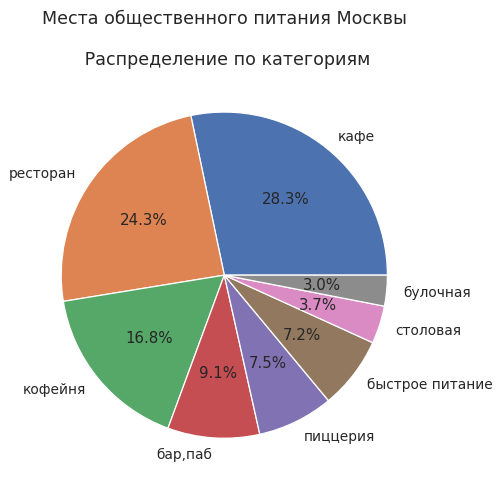

In [15]:
sns.set(style='white')
plt.figure(figsize=(10,6), dpi=90)
plt.pie(category_n['name'], labels = category_n['category'], autopct='%0.1f%%')
plt.title('Места общественного питания Москвы\n\n Распределение по категориям', fontsize=14);

Кафе и рестораны вместе составляют 52,6% от общего числа заведений, при этом кафе занимают первое место по численности, обгоняя рестораны на 4%. На третьем месте - кофейни, 16% от общего числа.

<a id='seats'></a>  
### Анализ количества посадочных мест  
[(к заголовку)](#title)  

Теперь узнаем, как отличаются категории заведений по количеству посадочных мест.  
Выделим из датасета только те строки, где есть информация в столбце `seats`:

In [17]:
data_seats = data.dropna(subset=['seats'])
data_seats.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4793 entries, 1 to 8401
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               4793 non-null   object 
 1   category           4793 non-null   object 
 2   address            4793 non-null   object 
 3   district           4793 non-null   object 
 4   hours              4493 non-null   object 
 5   lat                4793 non-null   float64
 6   lng                4793 non-null   float64
 7   rating             4793 non-null   float64
 8   price              2050 non-null   object 
 9   avg_bill           2371 non-null   object 
 10  middle_avg_bill    1990 non-null   float64
 11  middle_coffee_cup  299 non-null    float64
 12  chain              4793 non-null   int64  
 13  seats              4793 non-null   float64
 14  street             4793 non-null   object 
 15  is_24_7            4793 non-null   bool   
dtypes: bool(1), float64(6), 

Проверим статистику распределения количества мест по категориям заведений.  
Отсортируем по медиане, как наиболее устойчивому к влиянию аномальных выбросов параметру:

In [18]:
data_seats_stat = data_seats.groupby(by='category').agg({'seats':['count','min','mean','median','max']}).sort_values(by=('seats','median'),ascending=False)
display(data_seats_stat)

seats                                
                count  min        mean median     max
category                                             
ресторан         1268  0.0  121.980284   86.0  1288.0
бар,паб           468  0.0  124.532051   82.5  1288.0
кофейня           751  0.0  111.199734   80.0  1288.0
столовая          164  0.0   99.750000   75.5  1200.0
быстрое питание   349  0.0   98.891117   65.0  1040.0
кафе             1218  0.0   97.512315   60.0  1288.0
пиццерия          427  0.0   94.496487   55.0  1288.0
булочная          148  0.0   89.385135   50.0   625.0

Визуализируем распределения количества мест по разным категориям:

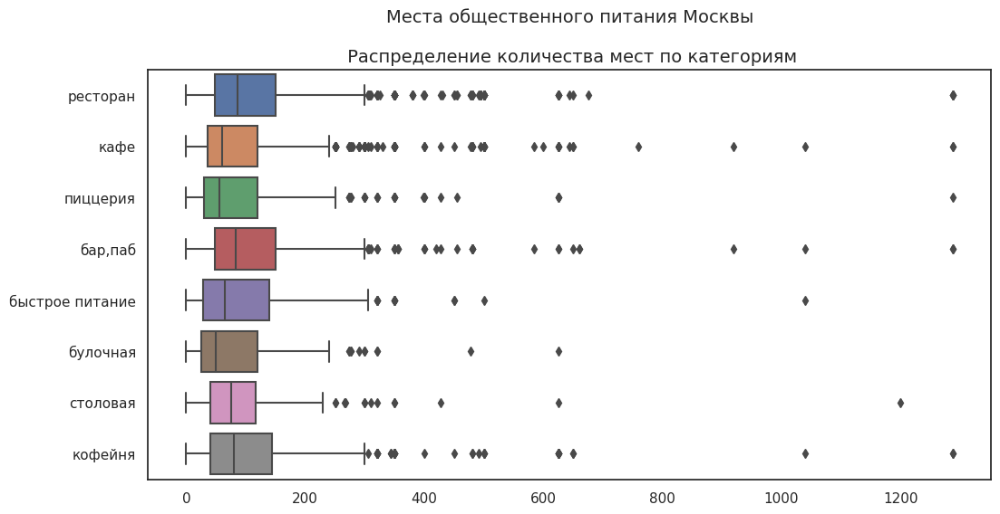

In [19]:
plt.figure(figsize=(12,6), dpi=100)
sns.boxplot(data=data_seats, y='category',x='seats')
plt.title('Места общественного питания Москвы\n\n Распределение количества мест по категориям', fontsize=14)
plt.xlabel('')
plt.ylabel('');

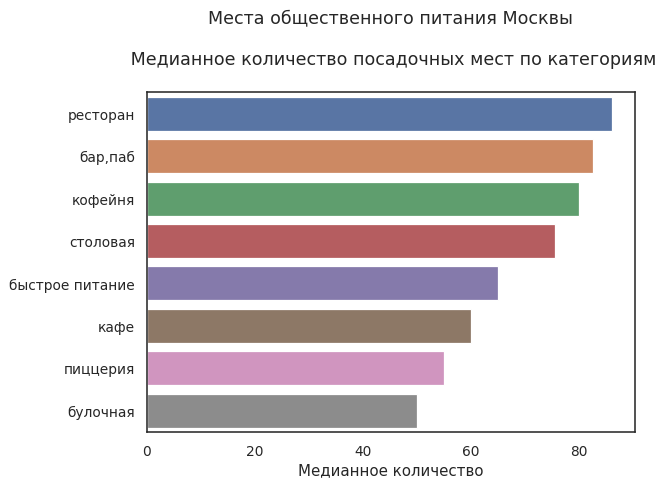

In [20]:
plt.figure(figsize=(7,5), dpi=90)
sns.barplot(data=data_seats_stat, y=data_seats_stat.index, x=('seats','median'))
plt.title('Места общественного питания Москвы\n\n Медианное количество посадочных мест по категориям\n', fontsize=14)
plt.xlabel('Медианное количество')
plt.ylabel('');

Из таблицы и графиков видно, что медианное значение количества мест в заведениях варьирует от 50 до 86, а 90-й процентиль не превышает 300. Аномально большие значения, от 300 до 1288 посадочных мест, сравнимые с количеством мест у небольшого стадиона, скорее всего говорят о обширных фудкортах различных торгово-развлекательных центров.  
Также имеем в виду, что из рассмотрения по причине отсутствия информации о количестве посадочных мест были исключены 3609 заведений.

<a id='chain'></a>  
### Анализ заведений по признаку отношения к сети  
[(к заголовку)](#title)  

In [21]:
# общее кол-во сетевых и несетевых заведений:
data_chain_and_not = data.groupby('chain',as_index=False)['name'].count()
display(data_chain_and_not)

,chain,name
0,0,5198
1,1,3204


In [22]:
data_chain_and_not['chain'] = data_chain_and_not['chain'].astype(str)
data_chain_and_not.loc[0,'chain'] = 'несетевые'
data_chain_and_not.loc[1,'chain'] = 'сетевые'

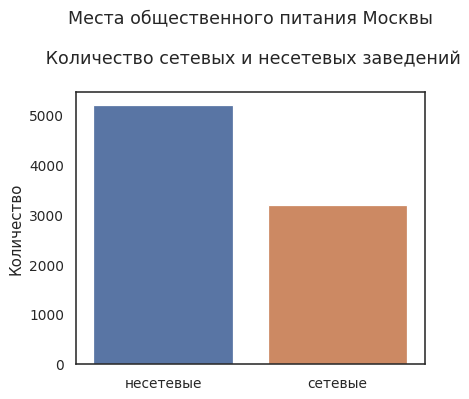

In [23]:
plt.figure(figsize=(5,4), dpi=90)
sns.barplot(data=data_chain_and_not, 
            x='chain', 
            y='name')
plt.title('Места общественного питания Москвы\n\n Количество сетевых и несетевых заведений\n', fontsize=14)
plt.ylabel('Количество')
plt.xlabel('');

Несетевых заведений больше. Всего 3200 из 8400, т.е. 38%, принадлежат к какой-либо сети.

Узнаем, какие категории заведений чаще являются сетевыми:

In [24]:
# подсчет кол-ва сетевых заведений по категориям:
data_chain_cat = data.query('chain == 1').groupby('category',as_index=False)['name'].count()
data_chain_cat.columns = ['category','chain']
# подсчет общего кол-ва заведений по категориям:
data_chain_cat['total'] = data.groupby('category',as_index=False)['name'].count()['name']
# подсчет процента сетевых заведений по категориям:
data_chain_cat['chain_percent'] = round(100*data_chain_cat['chain']/data_chain_cat['total'],2)

display(data_chain_cat.sort_values(by='chain_percent', ascending=False))

,category,chain,total,chain_percent
1,булочная,157,256,61.33
5,пиццерия,330,633,52.13
4,кофейня,720,1413,50.96
2,быстрое питание,232,603,38.47
6,ресторан,729,2040,35.74
3,кафе,779,2377,32.77
7,столовая,88,315,27.94
0,"бар,паб",169,765,22.09


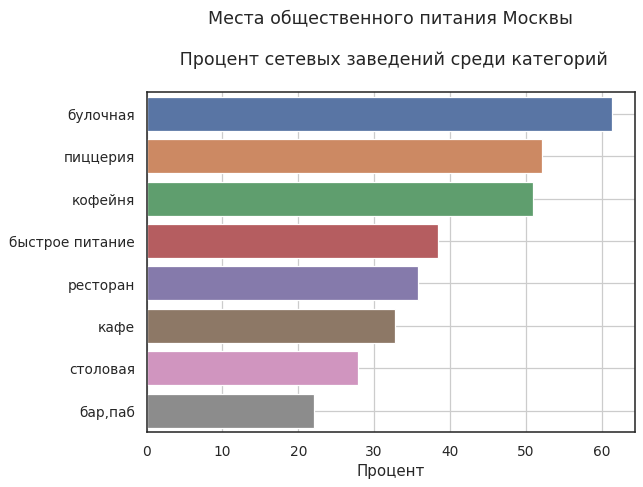

In [25]:
plt.figure(figsize=(7,5), dpi=90)
sns.barplot(data=data_chain_cat.sort_values('chain_percent',ascending=False), 
            y='category', 
            x='chain_percent')
plt.title('Места общественного питания Москвы\n\n Процент сетевых заведений среди категорий\n', fontsize=14)
plt.xlabel('Процент')
plt.ylabel('')
plt.grid();

Доля сетевых заведений больше всего среди булочных. Бары и пабы больше всех любят индивидуализм. Среди пиццерий и кофеен процент сетевых заведений тоже высок - 52,13 и 50,96% соответственно.

Теперь узнаем, какие сети имеют наибольшее количество своих заведений в Москве, и, заодно, проверим, все ли точки одной сети имеют в нашем датасете одну и ту же категорию:

In [26]:
data_chain_names = (data.query('chain == 1')
                    .groupby('name').agg({'category':['count','unique']})
                    .sort_values(by=('category','count'),ascending=False)
                   )
# выведем топ-15
display(data_chain_names.head(15))

category  \
                                       count   
name                                           
Шоколадница                              120   
Домино'с Пицца                            76   
Додо Пицца                                74   
One Price Coffee                          71   
Яндекс Лавка                              69   
Cofix                                     65   
Prime                                     50   
Хинкальная                                44   
КОФЕПОРТ                                  42   
Кулинарная лавка братьев Караваевых       39   
Теремок                                   38   
Чайхана                                   37   
CofeFest                                  32   
Буханка                                   32   
Му-Му                                     27   

                                                                                                              
                                                                                                      unique  
name                                                                                                          
Шоколадница                                                                                  [кофейня, кафе]  
Домино'с Пицца                                                                                    [пиццерия]  
Додо Пицца                                                                                        [пиццерия]  
One Price Coffee                                                                                   [кофейня]  
Яндекс Лавка                                                                                      [ресторан]  
Cofix                                                                                              [кофейня]  
Prime                                                                                       [ресторан, кафе]  
Хинкальная                                              [быстрое питание, кафе, ресторан, столовая, бар,паб]  
КОФЕПОРТ                                                                                           [кофейня]  
Кулинарная лавка братьев Караваевых                                                                   [кафе]  
Теремок                                                                          [ресторан, быстрое питание]  
Чайхана                                                                    [кафе, быстрое питание, ресторан]  
CofeFest                                                                                     [кофейня, кафе]  
Буханка                                                                            [булочная, кофейня, кафе]  
Му-Му                                [кафе, ресторан, кофейня, быстрое питание, пиццерия, столовая, бар,паб]

Некоторые сети предлагают настолько разнообразные услуги, что их заведения можно причислить к нескольким категориям. Чемпионом в этом в нашем топ-15 стала сеть "Му-Му" - семь категорий на 27 точек!  
Но, в основном, сети соблюдают свое направление деятельности - 7 из 15 имеют одну категорию, 4 из 15 - две. Также, 11 сетей из 14 связаны с кофе.

Подготовим данные для визуализации, из каких категорий сложены сети в нашей топ-15:

In [27]:
data_chain_stacked = pd.DataFrame(data_chain_names.head(15).sort_values(('category','count')).index)
list_cat = category_n['category']
for cat in list_cat:
    v_list = []
    for name in data_chain_stacked['name']:
        v_list.append(data
                      .query('name == @name and category == @cat')['name']
                      .count()
                     )
    data_chain_stacked[cat] = v_list

display(data_chain_stacked)

,name,кафе,ресторан,кофейня,"бар,паб",пиццерия,быстрое питание,столовая,булочная
0,Му-Му,12,8,2,1,1,2,1,0
1,CofeFest,1,0,31,0,0,0,0,0
2,Буханка,1,0,6,0,0,0,0,25
3,Чайхана,26,9,0,0,0,2,0,0
4,Теремок,0,36,0,0,0,2,0,0
5,Кулинарная лавка братьев Караваевых,39,0,0,0,0,0,0,0
6,КОФЕПОРТ,0,0,42,0,0,0,0,0
7,Хинкальная,19,15,0,3,0,6,1,0
8,Prime,1,49,0,0,0,0,0,0
9,Cofix,0,0,65,0,0,0,0,0


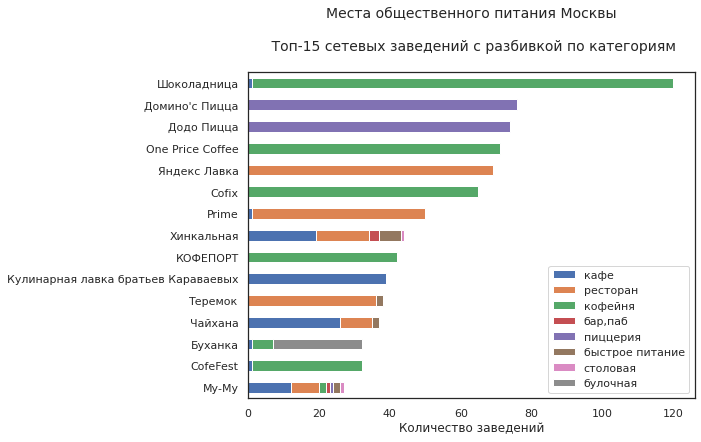

In [28]:
# визуализируем
data_chain_stacked.set_index('name').plot.barh(stacked=True, figsize=(8,6))
plt.title('Места общественного питания Москвы\n\n Топ-15 сетевых заведений с разбивкой по категориям\n', fontsize=14)
plt.xticks(rotation=0)
plt.ylabel('')
plt.xlabel('Количество заведений')
plt.show();

Кофейни, пиццерии, кафе и рестораны - основные, по численности, категории сетевых заведений. Но в топе-15, очевидно, больше кофеен.  
Все названия на слуху, но, почему-то, нет многих других популярных сетевых заведений: "Subway", "Ростикс" или "KFC".

<a id='destination'></a>  
### Анализ заведений по расположению  
[(к заголовку)](#title)  

Отобразим распределение заведений по административным округам, в том числе с разбивкой по категориям.

Посчитаем сначала общее количество заведений по округам и отсортируем по убыванию:

In [29]:
data_district_n = data.groupby('district')['name'].count().sort_values(ascending=False)
display(data_district_n)

district
Центральный административный округ         2242
Северный административный округ             898
Южный административный округ                892
Северо-Восточный административный округ     891
Западный административный округ             851
Восточный административный округ            796
Юго-Восточный административный округ        714
Юго-Западный административный округ         709
Северо-Западный административный округ      409
Name: name, dtype: int64

In [30]:
data_district_stacked = pd.DataFrame(data_district_n.sort_values().index)

for cat in list_cat:
    v_list = []
    for district in data_district_stacked['district']:
        v_list.append(data
                      .query('district == @district and category == @cat')['name']
                      .count()
                     )
    data_district_stacked[cat] = v_list

display(data_district_stacked)

,district,кафе,ресторан,кофейня,"бар,паб",пиццерия,быстрое питание,столовая,булочная
0,Северо-Западный административный округ,115,109,62,23,40,30,18,12
1,Юго-Западный административный округ,238,168,96,38,64,61,17,27
2,Юго-Восточный административный округ,282,145,89,38,55,67,25,13
3,Восточный административный округ,271,159,105,53,72,71,40,25
4,Западный административный округ,239,218,150,50,71,62,24,37
5,Северо-Восточный административный округ,269,182,159,63,68,82,40,28
6,Южный административный округ,264,202,131,68,73,85,44,25
7,Северный административный округ,235,187,193,68,77,58,41,39
8,Центральный административный округ,464,670,428,364,113,87,66,50


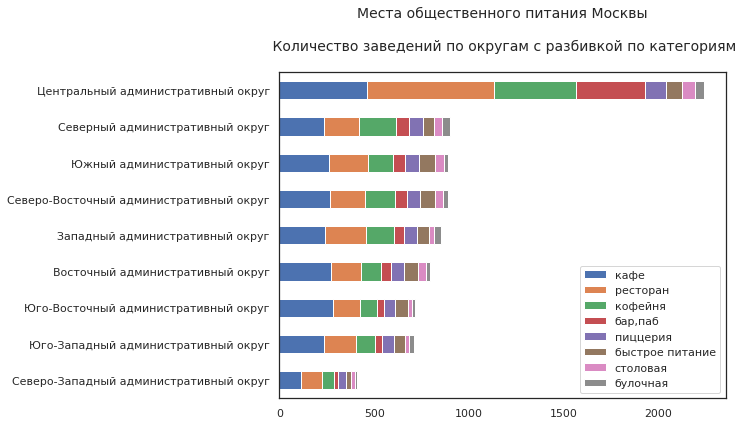

In [31]:
# визуализируем
data_district_stacked.set_index('district').plot.barh(stacked=True, figsize=(8,6))
plt.title('Места общественного питания Москвы\n\n Количество заведений по округам с разбивкой по категориям\n', fontsize=14)
plt.xticks(rotation=0)
plt.ylabel('')
plt.show();

Со значительным преимуществом по количеству точек общепита побеждает ЦАО. Утолить голод или жажду там можно с разнообразием в два с лишним раза превышающим любой другой округ и в пять раз превышающим СЗАО. Почему подобных заведений так мало на северо-западе, и вообще, почему районы так сильно отличаются по количеству заведений общественного питания? Предположительно, несмотря на то, что другие административные округа больше по размерам, чем Центральный, в Центральном жителей меньше, но значительно больше достопримечтельностей, офисов и учреждений культуры. То есть, люди, находясь вне дома - на работе, прогулке или культурном мероприятии, - чаще нуждаются в местах общественного питания, чем находясь у себя дома, в спальном районе.  
На графике видно, что количество баров/пабов в ЦАО сравнимо с кафе и кофейнями, тогда как в других округах процент баров гораздо меньше.  

Сравним с численностью населения в этих округах:

In [32]:
# для дополнительного анализа, численность населения Москвы на 2024 г., Википедия:
moscow_popupation = pd.DataFrame([774430,1217909,1768752,1455811,1425114,1508678,1515787,1435550,1039596], 
                                 index=data_district_stacked['district'],
                                 columns=["Численность населения"])
display(moscow_popupation)

,Численность населения
district,
Северо-Западный административный округ,774430
Юго-Западный административный округ,1217909
Юго-Восточный административный округ,1768752
Восточный административный округ,1455811
Западный административный округ,1425114
Северо-Восточный административный округ,1508678
Южный административный округ,1515787
Северный административный округ,1435550
Центральный административный округ,1039596


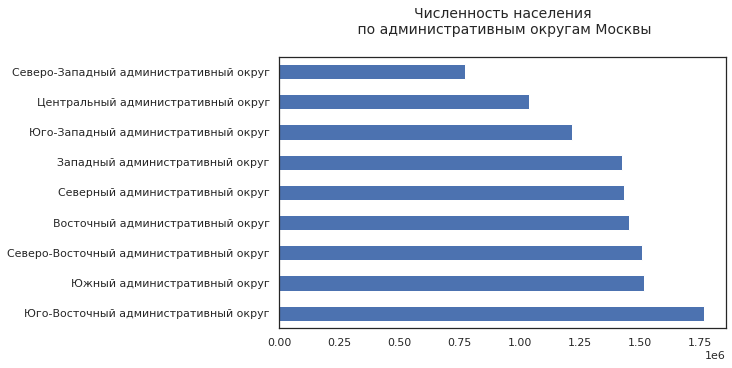

In [33]:
# визуализируем
moscow_popupation.sort_values(by='Численность населения',ascending=False).plot.barh(figsize=(8,5),legend=False)
plt.title('Численность населения\n по административным округам Москвы\n', fontsize=14)
plt.xticks(rotation=0)
plt.ylabel('')
plt.show();

Меньшее количество заведений общепита в СЗАО по сравнению с другими округами теперь можно объяснить меньшим количеством жителей.  
Теперь также можно примерно посчитать, что количество мест общественного питания в ЦАО в отношении к количеству проживающего там населения примерно в пять раз больше, чем в других административных округах.

<a id='rating'></a>
### Анализ рейтинга заведений  
[(к заголовку)](#title)  

Узнаем распределение средних рейтингов по категориям заведений.

In [34]:
# выведем статистику распределения рейтингов по категориям:
data_rating_stat = (data
                    .groupby(by='category')
                    .agg({'rating':['count','min','mean','median','max']})
                    .sort_values(by=('rating','median'),ascending=False)
                   )
display(data_rating_stat)

rating                           
                 count  min      mean median  max
category                                         
бар,паб            765  1.1  4.387712    4.4  5.0
булочная           256  1.3  4.268359    4.3  5.0
кофейня           1413  1.4  4.277282    4.3  5.0
пиццерия           633  1.0  4.301264    4.3  5.0
ресторан          2040  1.0  4.290343    4.3  5.0
столовая           315  1.0  4.211429    4.3  5.0
быстрое питание    603  1.1  4.050249    4.2  5.0
кафе              2377  1.0  4.123938    4.2  5.0

Визуализируем распределение в виде "ящиков с усами":

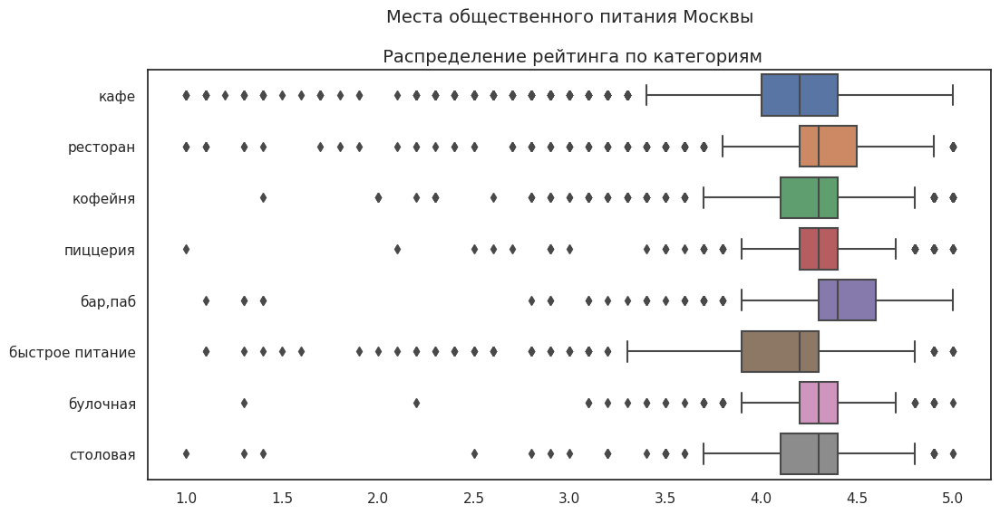

In [35]:
plt.figure(figsize=(12,6), dpi=100)
sns.boxplot(data=data, y='category',x='rating')
plt.title('Места общественного питания Москвы\n\n Распределение рейтинга по категориям', fontsize=14)
plt.xlabel('')
plt.ylabel('');

Медианные значения среднего рейтинга для всех категорий лежат в узком диапазоне 4.2 - 4.4.  
Только две категории "упираются" в "пятерку" - кафе и бары/пабы, для остальных "5" это аномальная величина.

<a id='geography'></a>
### Анализ географии  
[(к заголовку)](#title)  

Построим хороплет со средним рейтингом по округам Москвы. Подготовим данные:

In [36]:
data_district_rating = data.groupby('district', as_index=False)['rating'].mean().round(2)
display(data_district_rating)

,district,rating
0,Восточный административный округ,4.17
1,Западный административный округ,4.18
2,Северный административный округ,4.24
3,Северо-Восточный административный округ,4.15
4,Северо-Западный административный округ,4.21
5,Центральный административный округ,4.38
6,Юго-Восточный административный округ,4.10
7,Юго-Западный административный округ,4.17
8,Южный административный округ,4.18


In [37]:
try:
    with open('datasets/admin_level_geomap.geojson', 'r', encoding="utf-8") as f:
        geo_json = json.load(f)
except:
    with open('/datasets/admin_level_geomap.geojson', 'r', encoding="utf-8") as f:
        geo_json = json.load(f)

moscow_lat, moscow_lng = 55.751244, 37.618423
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

Choropleth(
    geo_data=geo_json,
    data=data_district_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам'
).add_to(m)
m

Центральный округ имеет более рейтинговые заведения, чем остальные округа, при самой большой численности заведений. А вот жителям ЮВАО повезло меньше - самый низкий средний рейтинг.

Отобразим на карте все заведения:

In [38]:
marker_cluster = MarkerCluster().add_to(m)
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        tooltip=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

data.apply(create_clusters, axis=1)
m

Найдем распределение количества заведений общепита по улицам. Составим топ-15:

In [39]:
data_streets_n_15 = data.groupby('street')['name'].count().sort_values(ascending=False).reset_index().head(15)
display(data_streets_n_15)

,street,name
0,проспект Мира,184
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


Добавим информацию о длине улицы (Википедия) и посчитаем плотность размещения мест общепита на той или иной улице:

In [40]:
length_list = [8.9, 9.3, 8, 14, 5.6, 15.5, 12, 22.5, 19.7, 108.9, 8.6, 4.9, 8.3, 3.6, 1.8]
data_streets_n_15.insert(loc=len(data_streets_n_15.columns), column='length', value=length_list)
data_streets_n_15['density'] = round(data_streets_n_15['name']/data_streets_n_15['length'],2)
display(data_streets_n_15)

,street,name,length,density
0,проспект Мира,184,8.9,20.67
1,Профсоюзная улица,122,9.3,13.12
2,проспект Вернадского,108,8.0,13.50
3,Ленинский проспект,107,14.0,7.64
4,Ленинградский проспект,95,5.6,16.96
5,Дмитровское шоссе,88,15.5,5.68
6,Каширское шоссе,77,12.0,6.42
7,Варшавское шоссе,76,22.5,3.38
8,Ленинградское шоссе,70,19.7,3.55
9,МКАД,65,108.9,0.60


Пятницкая улица, одна из старейших улиц Москвы, расположена в Центральном округе, и у нее самая высокая плотность размещения точек общепита, 48 штук всего на 1.8 км длины.

Построим столбчатый график с накоплением для улиц из таблицы выше, с разбивкой по категориям:

In [41]:
data_streets_stacked = pd.DataFrame(data_streets_n_15.sort_values('name')['street'])

for cat in list_cat:
    v_list = []
    for street in data_streets_stacked['street']:
        v_list.append(data
                      .query('street == @street and category == @cat')['name']
                      .count()
                     )
    data_streets_stacked[cat] = v_list

display(data_streets_stacked)

,street,кафе,ресторан,кофейня,"бар,паб",пиццерия,быстрое питание,столовая,булочная
14,Пятницкая улица,7,18,6,9,3,2,0,3
13,улица Миклухо-Маклая,21,15,4,3,2,4,0,0
12,Кутузовский проспект,14,16,13,2,3,2,3,1
11,улица Вавилова,15,12,10,2,3,11,0,2
10,Люблинская улица,26,10,11,5,1,5,2,0
9,МКАД,45,5,4,1,0,9,1,0
8,Ленинградское шоссе,13,26,13,5,3,5,3,2
7,Варшавское шоссе,18,20,14,6,4,7,7,0
6,Каширское шоссе,20,19,16,2,5,10,5,0
5,Дмитровское шоссе,23,24,11,6,8,10,4,2


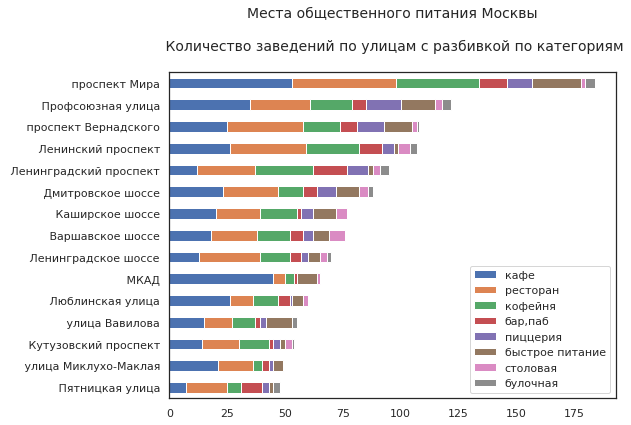

In [42]:
# визуализируем
data_streets_stacked.set_index('street').plot.barh(stacked=True, figsize=(8,6))
plt.title('Места общественного питания Москвы\n\n Количество заведений по улицам с разбивкой по категориям\n', fontsize=14)
plt.xticks(rotation=0)
plt.ylabel('')
plt.show();

Бросается в глаза отличие МКАД от других улиц. Вполне логично, что на окружной дороге практически нет пабов (1 шт., пить алкоголь за рулем ззапрещено) и относительно мало ресторанов. Оживленная транзитная трасса - не очень привлекательное место для гурманов. Зато много кафе, чтобы перекусить, не тратя много времени на задержку в пути.

Теперь найдем улицы, где есть только одно заведение общепита:

In [43]:
data_streets_one_place = data.groupby('street')['name'].count().reset_index().query('name == 1')
display(data_streets_one_place.head(10))
display(data_streets_one_place.tail(10))

,street,name
0,1-й Автозаводский проезд,1
1,1-й Балтийский переулок,1
2,1-й Варшавский проезд,1
3,1-й Вешняковский проезд,1
5,1-й Голутвинский переулок,1
6,1-й Грайвороновский проезд,1
7,1-й Дербеневский переулок,1
9,1-й Земельный переулок,1
10,1-й Капотнинский проезд,1
11,1-й Кирпичный переулок,1


,street,name
1416,улица Уткина,1
1418,улица Фадеева,1
1421,улица Фотиевой,1
1432,улица Чечулина,1
1433,улица Чистова,1
1436,улица Шкулёва,1
1437,улица Шкулёва 4,1
1439,улица Шухова,1
1442,улица Юннатов,1
1447,№ 7,1


Скорее всего, это или очень маленькие улицы (переулки), или проезды в промышленных районах, или небольшие улицы на окраине города. Или ошибки в указании адреса, как, например, строки №1437 или №1447. Узнаем какие категории заведений мы можем там найти: 

In [44]:
data_streets_one_place_cat = (data
                              .query('street in @data_streets_one_place["street"]')
                              .groupby('category')['name'].count()
                              .sort_values(ascending=False)
                              .reset_index()
                             )
display(data_streets_one_place_cat)

,category,name
0,кафе,160
1,ресторан,93
2,кофейня,84
3,"бар,паб",39
4,столовая,36
5,быстрое питание,23
6,пиццерия,15
7,булочная,8


<a id='alone_cat'></a>
Почти ничего не изменилось в сравнении с [распределением](#total_cat) общего количества представленных заведений. Разве что пиццерии переместились ближе к концу списка.

<a id='bill'></a>
### Анализ среднего чека, столбец `middle_avg_bill`  
[(к заголовку)](#title)  

Узнаем, есть ли зависимость величины среднего чека заведения от географического расположения:

In [45]:
data_mab = data.dropna(subset=['middle_avg_bill'])
display(data_mab.head(5))
data_mab.info()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.890752,37.524653,4.4,средние,Средний счёт:199 ₽,199.0,NaN,0,45.0,Клязьминская улица,False
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00",55.890636,37.524303,4.7,средние,Средний счёт:200–300 ₽,250.0,NaN,0,45.0,Клязьминская улица,False


<class 'pandas.core.frame.DataFrame'>
Int64Index: 3149 entries, 1 to 8399
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               3149 non-null   object 
 1   category           3149 non-null   object 
 2   address            3149 non-null   object 
 3   district           3149 non-null   object 
 4   hours              3143 non-null   object 
 5   lat                3149 non-null   float64
 6   lng                3149 non-null   float64
 7   rating             3149 non-null   float64
 8   price              2679 non-null   object 
 9   avg_bill           3149 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  0 non-null      float64
 12  chain              3149 non-null   int64  
 13  seats              1990 non-null   float64
 14  street             3149 non-null   object 
 15  is_24_7            3149 non-null   bool   
dtypes: bool(1), float64(6), 

Посчитаем медианный средний чек для каждого округа:

In [46]:
data_district_mab = (data_mab
                     .groupby('district', as_index=False)
                     .agg({'middle_avg_bill':['median','count']})
                     .round(2)
                     .sort_values(('middle_avg_bill','median'), ascending=False)
                    )
display(data_district_mab)

district middle_avg_bill      
                                                    median count
1          Западный административный округ          1000.0   306
5       Центральный административный округ          1000.0  1060
4   Северо-Западный административный округ           700.0   157
2          Северный административный округ           650.0   322
7      Юго-Западный административный округ           600.0   235
0         Восточный административный округ           575.0   260
3  Северо-Восточный административный округ           500.0   301
8             Южный административный округ           500.0   314
6     Юго-Восточный административный округ           450.0   194

Построим хороплет с раскраской округов в зависимости от медианного среднего чека:

In [47]:
m_bill = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

Choropleth(
    geo_data=geo_json,
    data=data_district_mab,
    columns=['district', ('middle_avg_bill','median')],
    key_on='feature.name',
    fill_color='GnBu',
    fill_opacity=0.9,
    legend_name='Средний чек по районам'
).add_to(m_bill)
m_bill

Какие наблюдения можно сделать по картинке?  
В 2022 году жители и гости ЦАО и ЗАО чаще всего оставляли в шикарных местных ресторанах по 1000 рублей. Запросы точек общепита в САО и СЗАО были скромнее - от 650 до 700 рублей. Недорогие столовки ЮЗАО и ВАО позволяли утолить голод всего за сумму около 600 рублей. Те же люди, кто мог выделить себе на обед только 450-500 р., должны были ехать в СВАО, ЮВАО или ЮАО, которые в то время славились своими дешевыми забегаловками.  
  
Причины цветовой дифференциации округов это, скорее всего, отличия в аренде помещения и оплате труда персонала, каковые статьи могут составлять от 25 до 40 процентов выручки. В центре и на западе аренда помещений дороже, чем в остальных округах. Центр - это учреждения культуры, достопримечательности, офисы крупных фирм и государственные учреждения. Запад - это Кутузовский проспект и Рублевское шоссе, элитная недвижимость и офисы.  
Возможно, такая высокая конкуренция, какая есть в ЦАО, (в два с половиной раза больше заведений, чем в любом другом округе) могла бы снизить цены, но расходы на аренду и оплату персонала не позволяют это сделать.  

Будем иметь в виду, что информация о среднем чеке была только у 3149 заведений из 8402.

### Вывод по разделу:  

В представленном датасете места общественного питания Москвы поделены на восемь категорий. Перечислим их в порядке уменьшения доли в общем количестве: кафе, рестораны, кофейни, бары(пабы), пиццерии, быстрое питание, столовые, булочные. Две первые категории вместе занимают 52.6% от общего количества. Медианное количество посадочных мест в таких заведениях составляет от 60 до 86.  
  
В общем количестве в 8402 заведения, 3200, то есть 38%, являются сетевыми. Большая часть из них это так же кафе, рестораны и кофейни, но относительно распределения общего числа, в сети объединено только 32% кафе и 35% ресторанов, при том что сетевых булочных - 61.3%.  
Сложность анализа сетевых заведений по категориям проявилась в том, что точки одной и той же сети пользователи могли причислить к разным категориям, рекорд - 7 разных категорий у сети "Му-Му". Также, в таблице нет нескольких популярных сетей, например, "Ростикс", "Subway" и "KFC", а "Burger King" представлена всего 14-ю заведениями на всю Москву, причем названных по-русски "Бургер Кинг".  
  
Анализ заведений по географическому расположению ярко выделил Центральный административный округ из числа других округов. Центр Москвы имеет следующие особенности:
- большее минимум в два с половиной раза количество заведений по сравнению с другими районами, а если брать плотность относительно количества жителей, то плотность мест общепита в центре минимум в пять раз превышает другой район;
- более высокий средний рейтинг заведений;
- бОльшая доля баров и пабов, чем в других округах;
- усредненный средний чек - около 1000 руб., в других округах тот же показатель - максимум 700 р.  
Мы связываем эти особенности в первую очередь с высокой ценой квадратного метра помещений в центре Москвы, что делает арендную плату для владельцев заведений более высокой. Средний чек, возможно, был бы еще выше, если бы не конкуренция среди большого количества заведений. Та же конкуренция способствует улучшению качества сервиса, что и приводит к более высокому среднему рейтингу по округам.

----------------------------

<a id='detailing'></a>
## Детализация исследования
[(к заголовку)](#title)

По просьбе заказчика проведем более подробный анализ заведений категории "кофейня", чтобы помочь им с открытием своей собственной.

### Сколько всего кофеен в датасете? В каких районах их больше всего, какие особенности их расположения?

In [48]:
data_coffee_house = data.query('category == "кофейня"')
display(data_coffee_house.head(5))
data_coffee_house.info()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
25,В парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,NaN,парк Левобережный,False
45,9 Bar Coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46.0,Коровинское шоссе,False
46,CofeFest,кофейня,"Москва, улица Маршала Федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,1,NaN,улица Маршала Федоренко,False
52,Cofix,кофейня,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,1,NaN,улица Дыбенко,False


<class 'pandas.core.frame.DataFrame'>
Int64Index: 1413 entries, 3 to 8396
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               1413 non-null   object 
 1   category           1413 non-null   object 
 2   address            1413 non-null   object 
 3   district           1413 non-null   object 
 4   hours              1398 non-null   object 
 5   lat                1413 non-null   float64
 6   lng                1413 non-null   float64
 7   rating             1413 non-null   float64
 8   price              476 non-null    object 
 9   avg_bill           721 non-null    object 
 10  middle_avg_bill    200 non-null    float64
 11  middle_coffee_cup  521 non-null    float64
 12  chain              1413 non-null   int64  
 13  seats              751 non-null    float64
 14  street             1413 non-null   object 
 15  is_24_7            1413 non-null   bool   
dtypes: bool(1), float64(6), 

Всего в таблице 1413 кофейни.

In [49]:
data_coffee_house_districts_n = (data_coffee_house.groupby('district')
                                 .agg({'name':'count'})
                                 .sort_values(by='name',ascending=False)
                                )
display(data_coffee_house_districts_n)

,name
district,
Центральный административный округ,428
Северный административный округ,193
Северо-Восточный административный округ,159
Западный административный округ,150
Южный административный округ,131
Восточный административный округ,105
Юго-Западный административный округ,96
Юго-Восточный административный округ,89
Северо-Западный административный округ,62


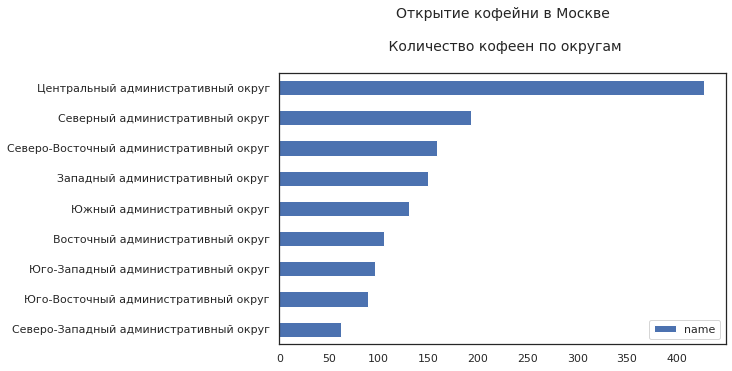

In [50]:
# визуализируем
data_coffee_house_districts_n.sort_values('name').plot.barh(figsize=(8,5))
plt.title('Открытие кофейни в Москве\n\n Количество кофеен по округам\n', fontsize=14)
plt.xticks(rotation=0)
plt.ylabel('')
plt.show();

### Есть ли круглосуточные кофейни?

In [51]:
def is24 (hour):
    w = 'круглосуточно' in str(hour)
    return w

is24 = data_coffee_house['hours'].apply(is24).sum()
print('Всего',is24,'круглосуточных кафеен,',round(100*is24/len(data_coffee_house),2),'% от общего числа.')

Всего 76 круглосуточных кафеен, 5.38 % от общего числа.


### Какие у кофеен рейтинги? Как они распределены по районам?

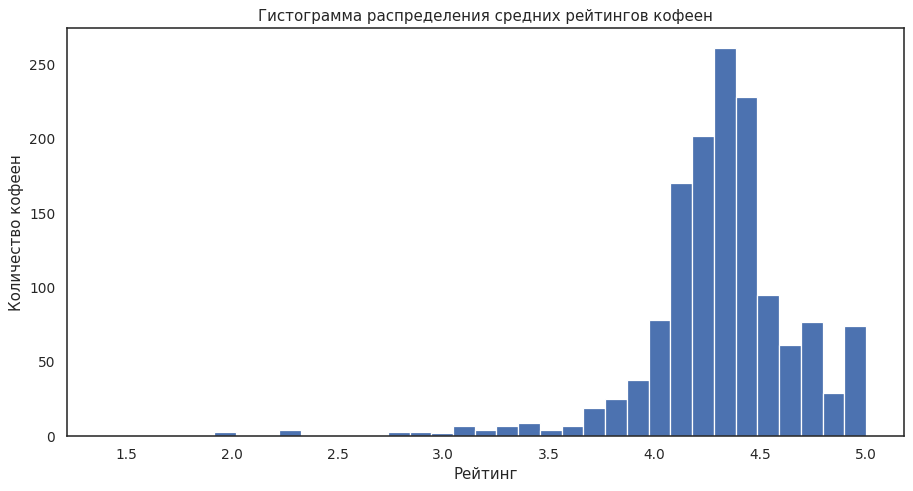

In [52]:
plt.figure(figsize=(12,6), dpi=90)
plt.hist(x=data_coffee_house['rating'],bins=35)
plt.title('Гистограмма распределения средних рейтингов кофеен', fontsize=12)
plt.xlabel('Рейтинг')
plt.ylabel('Количество кофеен');

In [53]:
data_coffee_house_district_rating = (data_coffee_house
                                .groupby('district')
                                .agg({'rating':'mean'})
                                .sort_values(by='rating',ascending=False)
                               )
display(data_coffee_house_district_rating)

,rating
district,
Центральный административный округ,4.336449
Северо-Западный административный округ,4.325806
Северный административный округ,4.291710
Юго-Западный административный округ,4.283333
Восточный административный округ,4.282857
Южный административный округ,4.232824
Юго-Восточный административный округ,4.225843
Северо-Восточный административный округ,4.216981
Западный административный округ,4.195333


Усредненный средний рейтинг кофеен по округам слабо отличается, разброс в диапазоне от 4.19 до 4.33. Самый высокий рейтинг - в ЦАО и СЗАО, самый низкий - у кофеен СВАО и ЗАО.

### На какую стоимость чашки капуччино стоит ориентироваться при открытии и почему?

Стоимость товара не должна сильно отличаться от стоимости товара конкурентов (только, конечно, если вы не знаете источников дешевой энергии, рабочей силы или сырья - тогда, да, можно смело демпинговать). Если цена будет выше - клиент уйдет к конкурентам, если ниже - издержки перестанут окупаться. В любом случае вы лишитесь прибыли и прогорите.  
В задании сказано, что кофейня должна быть крутой, доступной и чтобы можно было собраться большой компанией. Нам представляется, что клиентами данного заведения должны быть, преимущественно, студенты или офисные работники. Следовательно, наша кофейня должна быть расположена у станции метро (чтобы удобно было встретиться), или около ВУЗа, или в офисном квартале. А лучше всего, если все это будет там вместе. Также неплохо будет расположиться между ВУЗом и метро. Есть локации, где рядом расположены несколько учебных заведений - они тоже нам подходят.

Попробуем построить хороплет с средней ценой на капуччино по округам Москвы. Имеем в виду, что информация о цене кофе есть только для 521 заведения, поэтому выводы могут быть статистически не очень точными.

In [54]:
data_capuccino_district = (data_coffee_house
                           .groupby('district', as_index=False)
                           .agg({'middle_coffee_cup':['median','count']})
                           .round(2)
                           .sort_values(('middle_coffee_cup','median'), ascending=False)
                          )
display(data_capuccino_district)
print('Средняя стоимость чашки кофе в Москве: ', data['middle_coffee_cup'].mean().round(2),'рубля.')

district middle_coffee_cup      
                                                      median count
7      Юго-Западный административный округ             198.0    34
5       Центральный административный округ             190.0   162
1          Западный административный округ             189.0    49
4   Северо-Западный административный округ             165.0    21
3  Северо-Восточный административный округ             162.5    60
2          Северный административный округ             159.0    76
8             Южный административный округ             150.0    43
6     Юго-Восточный административный округ             147.5    34
0         Восточный административный округ             135.0    42

Средняя стоимость чашки кофе в Москве:  174.72 рубля.


In [55]:
marker_cluster = MarkerCluster().add_to(m)
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

data.apply(create_clusters, axis=1)
m

In [56]:
#создание карты с центром на Москве
m_capuccino = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

#добавление кластеров и маркеров кофеен
capuccino_cluster = MarkerCluster().add_to(m_capuccino)
def create_clusters(row):
    
    icon_url = 'https://img.icons8.com/?size=48&id=12860&format=png'  
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    Marker(
        [row['lat'], row['lng']],
        tooltip=f"{row['name']} {row['middle_coffee_cup']}",
        icon=icon
    ).add_to(capuccino_cluster)
    
#добавление хороплета для средней цены чашки капучино по округам
data_coffee_house.query('middle_coffee_cup.notna()').apply(create_clusters, axis=1)

Choropleth(
    geo_data=geo_json,
    data=data_capuccino_district,
    columns=['district', ('middle_coffee_cup','median')],
    key_on='feature.name',
    fill_color='YlOrBr',
    fill_opacity=0.6,
    legend_name='Средняя стоимость чашки капуччино'
).add_to(m_capuccino)

#добавление маркеров рекомендованных мест:
sokol_lat, sokol_lng = 55.80538, 37.51467
baum_lat, baum_lng =  55.77228, 37.67857
yugozap_lat, yugozap_lng = 	55.66464, 37.48421

def idea(lat,lng,name):
    idea_url = 'https://img.icons8.com/?size=40&id=41653&format=png'
    idea = CustomIcon(idea_url, icon_size=(50, 50))
    folium.Marker([lat,lng], tooltip=name,icon=idea).add_to(m_capuccino)
    
idea(sokol_lat, sokol_lng, 'Сокол')  
idea(baum_lat, baum_lng, 'Бауманская')
idea(yugozap_lat, yugozap_lng, 'Юго-Западная')

#отображение карты
m_capuccino

Мы знаем, что заказчик не боится конкуренции, поэтому не будем обращать внимание на количество уже открытых в потенциально привлекательных местах кофейнях.  
Безусловно, нужно будет тщательнее проанализировать географическое сочетание необходимых нам объектов, но уже три таких конгломерации нам известны:
- метро Сокол, МАИ, Росбиотех, РГХПУ им. Строганова, НИИ Гидропроект, НПО Алмаз, офисы;
- метро Бауманская, МГТУ им. Баумана, МИИЯ, Техникум космического приборостроения, ГУП, офисы;
- метро Юго-Западная, МИРЭА, РАНХИГС, офисы.

На хороплете они отмечены иконкой в виде лампочки.

-------------------------

<a id='resume'></a>
## Выводы:
[(к заголовку)](#title)

В ходе данного проекта был проведен анализ рынка услуг общественного питания города Москвы. Целью было изучить особенности, найти различия и закономерности, чтобы помочь заказчику с открытием своего заведения типа "кофейня".  
Исходный датасет представлен 8406 заведениями, он содержит информацию об уже существующих ресторанах, кафе и т.д.. Есть адрес и точные координаты заведения, количество мест, рейтинг, часы работы, средний счет и признак принадлежности к сети. Информация была составлена на основе сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года.  

Датасет был проверен на наличие дубликатов и пропусков. Были добавлены поля со вспомогательной информацией: улица, где располагается заведение, и признак работы заведения ежедневно и круглосуточно.  

Анализ информации датасета проводился по всем критериям, представлявшихся нам значимыми.  
1) В датасете представлены восемь категорий. По численности две первых места занимают кафе и рестораны, 28.3% и 24.3% соответственно, от общего числа, и они вместе представляют более половины заведений. На третьем месте - кофейни, 16.8%. На последнем месте - булочные, только 3%.  
2) Анализ количества посадочных мест показал, что основная часть заведений общепита имеют их от 20 до 120. Многие объединены в фудкорты торговых моллов.  
3) Из общего числа заведений мы выделили 3204, которые являются сетевыми. При визуализации мы выяснили, что многие сетевые заведения имеют разную категорию. Ресторан (или кафе? или бар?) "Му-Му", например, "собрал" целых семь.  
В топ-пятерку сетей по численности точек вошли кофейни ("Шоколадница", "OnePriceCoffee"), пиццерии ("Домино" и "ДоДо") и ресторан(Яндекс Лавка).  
4) Далее мы проверили, как заведения распределены по территории Москвы и заодно посмотрели, какие категории там представлены. Выяснилось, что более четверти всех заведений, 2242 штуки, находятся в Центральном административном округе. Самое меньшее количество - в СЗАО, - всего 409. Остальные же округа имеют от 700 до 900 заведений общепита. Доли категорий, по сравнению с общим распределением, примерно сохраняются для каждого округа, но в ЦАО выше процент баров.
5) Мы сравнили рейтинги заведений по категориям и округам. Больший средний рейтинг имеют бары, а среди округов в лучшую сторону выделяется Центральный, - оба в среднем на 0.1 минимум больше других. Лучший рейтинг заведений ЦАО объясняется, по нашему мнению, высокой конкуренцией.
6) Найдены улицы города с самым большим количеством заведений общепита. Чемпионом по плотности размещения таких мест стала Пятницкая улица, что в Центре Москвы. На ее длине всего в 1.8 км находится 48 заведений общественного питания.
7) Также был проанализирован средний чек заведений и найдены округа с наиболее дорогими заведениями, - ЗАО и ЦАО, и округ с самыми дешевыми в среднем ценами - это СВАО. У первых чек в два раза больше - 1000 рублей против 500. Это связано, по нашему мнению, с разницей в стоимости квадратного метра земли в разных округах.  

Для большей детальности были проанализированы отдельно кофейни Москвы, т.к. заказчик хочет открыть именно кофейню.  
По результатам исследования были даны рекомендации, где и почему это будет лучше сделать. Принимая во внимание пожелания заказчика, что кофейня должна быть "крутой и доступной", и размышляя в этом направлении, мы пришли к выводу, что ее посетители должны быть преимущественно людьми молодого возраста, студентами или офисными работниками. Соответственно, наше заведение должно располагаться как можно ближе к местам их активности. Это высшие учебные и средние специальные учебные заведения, офисные кварталы. Также, желательно, чтобы рядом была станция метро или легкого метро. Мы рекомендуем, предварительно, три таких, известных нам и подходящих под указанные условия, места: м.Сокол, м.Бауманская, м.Юго-Западная.